In [1]:
import tensorflow as tf

import os
import pathlib
import time
import datetime

from matplotlib import pyplot as plt
from IPython import display

In [2]:
dataset_name = "maps" #@param ["cityscapes", "edges2handbags", "edges2shoes", "facades", "maps", "night2day"]

In [3]:
# _URL = f'http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/{dataset_name}.tar.gz'

# path_to_zip = tf.keras.utils.get_file(
#     fname=f"{dataset_name}.tar.gz",
#     origin=_URL,
#     extract=True)

# path_to_zip  = pathlib.Path(path_to_zip)

# PATH = path_to_zip.parent/dataset_name

In [4]:
PATH = "data/maps/"

In [5]:
sample_image = tf.io.read_file(str(PATH + 'train/1.jpg'))
sample_image = tf.io.decode_jpeg(sample_image)
print(sample_image.shape)

(600, 1200, 3)


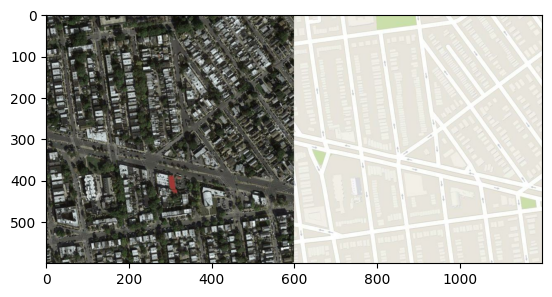

In [6]:
plt.figure()
plt.imshow(sample_image)

In [7]:
def load(image_file):
  # Read and decode an image file to a uint8 tensor
  image = tf.io.read_file(image_file)
  image = tf.io.decode_jpeg(image)

  # Split each image tensor into two tensors:
  # - one with a real building facade image
  # - one with an architecture label image 
  w = tf.shape(image)[1]
  w = w // 2
  input_image = image[:, w:, :]
  real_image = image[:, :w, :]

  # Convert both images to float32 tensors
  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)

  return input_image, real_image

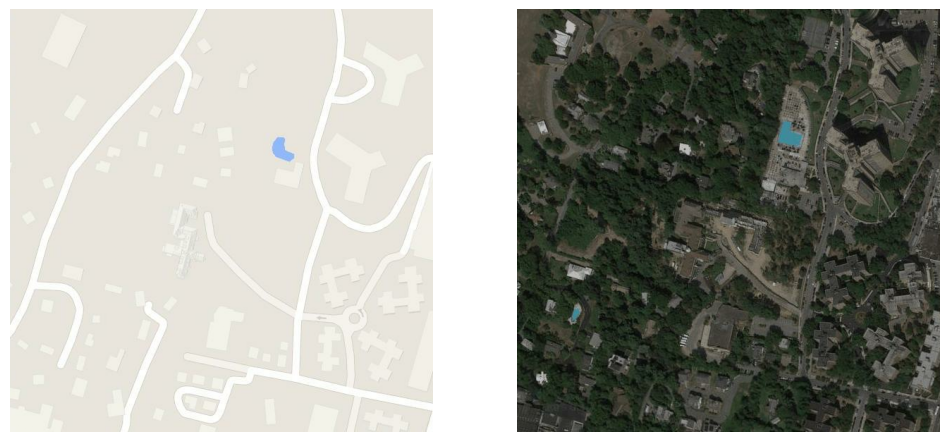

In [8]:
inp, re = load(str(PATH + 'train/100.jpg'))

plt.figure(figsize=(12, 6))  # Adjust width for 2 images side-by-side
for i in range(2):
  plt.subplot(1, 2, i + 1)  # 1 row, 2 columns, starting from 1 (top left)
  plt.imshow(inp / 255.0)  # Show only the first image (inp)
  plt.axis('off')

# Add another subplot to display the reconstructed image (re)
plt.subplot(1, 2, 2)  # Access the second subplot (top right)
plt.imshow(re / 255.0)  # Show the reconstructed image
plt.axis('off')

plt.show()

In [9]:
# The facade training set consist of 1000 images
BUFFER_SIZE = 1000
# The batch size of 1 produced better results for the U-Net in the original pix2pix experiment
BATCH_SIZE = 1
# Each image is 256x256 in size
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [10]:
def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return input_image, real_image

In [11]:
inp, re = resize(inp, re, IMG_HEIGHT, IMG_WIDTH)

In [12]:
def random_crop(input_image, real_image):
  stacked_image = tf.stack([input_image, real_image], axis=0)
  cropped_image = tf.image.random_crop(
      stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])

  return cropped_image[0], cropped_image[1]

In [13]:
# Normalizing the images to [-1, 1]
def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image

In [14]:
def gaussian_kernel(size, mean, std):
    """Creates a 2D Gaussian kernel with given parameters."""
    d = tf.range(-size // 2 + 1, size // 2 + 1, dtype=tf.float32)
    x, y = tf.meshgrid(d, d)
    kernel = tf.exp(-(tf.square(x - mean) + tf.square(y - mean)) / (2.0 * tf.square(std)))
    return kernel / tf.reduce_sum(kernel)

def apply_blur(input_image, real_image, kernel_size=5, sigma=1.0):
    # Create Gaussian kernel
    gauss_kernel = gaussian_kernel(kernel_size, 0.0, sigma)
    gauss_kernel = gauss_kernel[:, :, tf.newaxis, tf.newaxis]
    channels = tf.shape(input_image)[-1]
    gauss_kernel = tf.tile(gauss_kernel, [1, 1, channels, 1])

    # Apply Gaussian blur to both images using depthwise convolution
    input_image = tf.nn.depthwise_conv2d(input_image[tf.newaxis, ...], gauss_kernel, strides=[1, 1, 1, 1], padding='SAME')[0]
    return input_image, real_image

In [15]:
@tf.function()
def random_jitter(input_image, real_image):
  input_image, real_image = resize(input_image, real_image, 286, 286)
  input_image, real_image = random_crop(input_image, real_image)

  if tf.random.uniform(()) > 0.5:
    input_image = tf.image.flip_left_right(input_image)
    real_image = tf.image.flip_left_right(real_image)

  return input_image, real_image

In [16]:
def detect_edges(image_tensor):
    gray = tf.image.rgb_to_grayscale(image_tensor)
    gray = tf.image.convert_image_dtype(gray, tf.float32)
    sobel_x = tf.image.sobel_edges(gray)[..., 0]  # Extract x gradients
    sobel_y = tf.image.sobel_edges(gray)[..., 1]  # Extract y gradients
    edges = tf.sqrt(tf.square(sobel_x) + tf.square(sobel_y))
    
    return edges

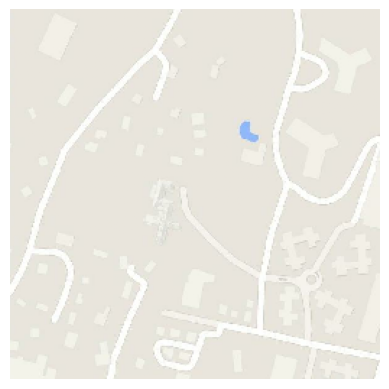

In [17]:
plt.imshow(inp / 255.0)
plt.axis('off')
plt.show()

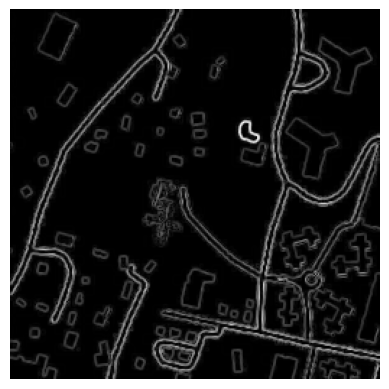

In [18]:
edg = detect_edges(inp[tf.newaxis, ...])
edges_numpy = edg.numpy()
plt.imshow(edges_numpy[0, ..., 0], cmap='gray')  # Assuming batch size is 1
plt.axis('off')
plt.show()

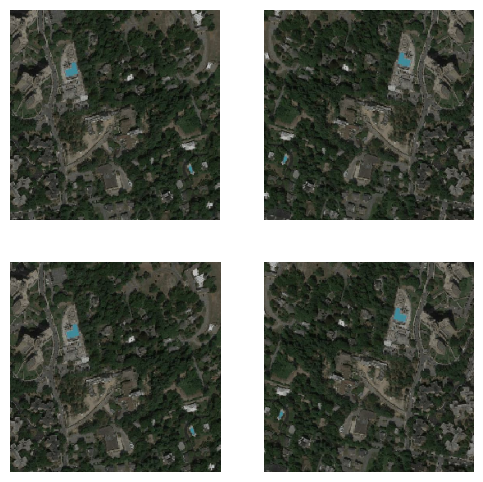

In [19]:
plt.figure(figsize=(6, 6))
for i in range(4):
  rj_inp, rj_re = random_jitter(inp, re)
  plt.subplot(2, 2, i + 1)
  plt.imshow(rj_inp / 255.0)
  plt.imshow(rj_re / 255.0)
  plt.axis('off')
plt.show()

In [20]:
def load_image_train(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = random_jitter(input_image, real_image)
  input_image, real_image = normalize(input_image, real_image)
  input_edges = tf.squeeze(detect_edges(input_image[tf.newaxis, ...]), axis=0)

  return input_image, input_edges, real_image

In [21]:
def load_image_test(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)
  input_edges = tf.squeeze(detect_edges(input_image[tf.newaxis, ...]), axis=0)

  return input_image, input_edges, real_image

In [22]:
train_dataset = tf.data.Dataset.list_files(str(PATH + 'train/*.jpg'))
train_dataset = train_dataset.map(load_image_train,
                                  num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

In [23]:
try:
  test_dataset = tf.data.Dataset.list_files(str(PATH + 'test/*.jpg'))
except tf.errors.InvalidArgumentError:
  test_dataset = tf.data.Dataset.list_files(str(PATH + 'val/*.jpg'))
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

In [24]:
OUTPUT_CHANNELS = 3

In [25]:
# def downsample(filters, size, strides):
#   initializer = tf.random_normal_initializer(0., 0.02)

#   result = tf.keras.Sequential()
#   conv2d = tf.keras.layers.Conv2D(filters, size, strides=strides, padding='same', kernel_initializer=initializer, use_bias=False)
#   snc = tf.keras.layers.SpectralNormalization(conv2d)
#   result.add(snc)

#   result.add(tf.keras.layers.LeakyReLU())

#   return result

In [26]:
# def upsample(filters, size, apply_dropout=False):
#   initializer = tf.random_normal_initializer(0., 0.02)

#   result = tf.keras.Sequential()
#   conv2d_t = tf.keras.layers.Conv2DTranspose(
#     filters, size, strides=2,
#     padding='same',
#     kernel_initializer=initializer,
#     use_bias=False
#   )
#   snct = tf.keras.layers.SpectralNormalization(conv2d_t)
#   result.add(snct)

#   if apply_dropout:
#     result.add(tf.keras.layers.Dropout(0.5))

#   result.add(tf.keras.layers.ReLU())

#   return result

In [27]:
# def attention_block(inputs, inputs_shape, gamma, output_channels):
#   batchsize = inputs_shape[0]
#   height = inputs_shape[1]
#   width = inputs_shape[2]
#   channels = output_channels
#   N = width * height
#   embedding_channels = output_channels//8

#   q = tf.keras.layers.Conv2D(filters=embedding_channels, kernel_size=1)(inputs)
#   q = tf.reshape(q, (batchsize, N, embedding_channels))
  
#   k = tf.keras.layers.Conv2D(filters=embedding_channels, kernel_size=1)(inputs)
#   k = tf.reshape(k, (batchsize, N, embedding_channels))
  
#   v = tf.keras.layers.Conv2D(filters=output_channels, kernel_size=1)(inputs)
#   v = tf.reshape(v, (batchsize, N, output_channels))
#   v = tf.transpose(v, (0,2,1))

#   energy = tf.matmul(q, k, transpose_b=True)
#   attention = tf.nn.softmax(energy)
  
#   out = tf.matmul(v, attention)
   
#   out = tf.reshape(tf.transpose(out, (0, 2, 1)), (batchsize, width, height, channels))

#   scale = ScaleLayer(gamma)(out)
 
#   sum = tf.add(scale, inputs)

#   return sum

In [28]:
class DownsampleLayer(tf.keras.layers.Layer):
  def __init__(self, filters, size, strides, padding):
    super(DownsampleLayer, self).__init__()
    self.filters = filters
    self.size = size
    self.strides = strides
    self.padding = padding

  def build(self, input_shape):
    initializer = tf.random_normal_initializer(0., 0.02)
    self.conv2d = tf.keras.layers.Conv2D(
        filters=self.filters, kernel_size=self.size, strides=self.strides,
        padding=self.padding, kernel_initializer=initializer, use_bias=False
    )
    self.bn = tf.keras.layers.BatchNormalization()
    self.leaky_relu = tf.keras.layers.LeakyReLU()

  def call(self, inputs):
    x = self.conv2d(inputs)
    x = self.bn(x)
    x = self.leaky_relu(x)
    return x

In [29]:
class UpsampleLayer(tf.keras.layers.Layer):
  def __init__(self, filters, size):
    super(UpsampleLayer, self).__init__()
    self.filters = filters
    self.size = size

  def build(self, input_shape):
    initializer = tf.random_normal_initializer(0., 0.02)
    self.conv2d_t = tf.keras.layers.Conv2DTranspose(
        filters=self.filters, kernel_size=(self.size, self.size), strides=2,
        padding='same', kernel_initializer=initializer, use_bias=False
    )
    self.bnt = tf.keras.layers.BatchNormalization()
    self.relu = tf.keras.layers.ReLU()

  def call(self, inputs):
    x = self.conv2d_t(inputs)
    x = self.bnt(x)
    x = self.relu(x)
    return x

In [30]:
class AttentionLayer(tf.keras.layers.Layer):
  def __init__(self, output_channels, inputs_shape):
    super(AttentionLayer, self).__init__()
    self.output_channels = output_channels
    self.inputs_shape = inputs_shape

  def build(self, input_shape):
    self.batch_size = self.inputs_shape[0]
    self.height = self.inputs_shape[1]
    self.width = self.inputs_shape[2]
    self.channels = self.output_channels // 8
    self.N = self.width * self.height

    self.q_conv = tf.keras.layers.Conv2D(filters=self.channels, kernel_size=1)
    self.k_conv = tf.keras.layers.Conv2D(filters=self.channels, kernel_size=1)
    self.v_conv = tf.keras.layers.Conv2D(filters=self.output_channels, kernel_size=1)
    self.gamma = self.add_weight(initializer=tf.initializers.Zeros, name=self.name + '_gamma')

  def call(self, inputs):
    q = self.q_conv(inputs)
    q = tf.reshape(q, [-1, self.N, self.channels])

    k = self.k_conv(inputs)
    k = tf.reshape(k, [-1, self.N, self.channels])

    v = self.v_conv(inputs)
    v = tf.reshape(v, [-1, self.N, self.output_channels])
    v = tf.transpose(v, perm=[0, 2, 1])

    energy = tf.matmul(q, k, transpose_b=True)
    attention = tf.nn.softmax(energy)

    out = tf.matmul(v, attention)
    out = tf.reshape(tf.transpose(out, perm=[0, 2, 1]), [-1, self.width, self.height, self.output_channels])

    return tf.add(tf.multiply(out, self.gamma), inputs)

In [31]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[256, 256, 3]) # (batch_size, 256, 256, 3)
  edge_input = tf.keras.layers.Input(shape=[256, 256, 1]) # (batch_size, 256, 256, 1)
  combined_input = tf.keras.layers.Concatenate()([inputs, edge_input]) # (batch_size, 256, 256, 6)

  down_stack = [
    DownsampleLayer(64, 4, 2, 'same'),  # (batch_size, 128, 128, 64)
    DownsampleLayer(128, 4, 2, 'same'),  # (batch_size, 64, 64, 128)
    DownsampleLayer(256, 4, 2, 'same'),  # (batch_size, 32, 32, 256)
    DownsampleLayer(512, 4, 2, 'same'),  # (batch_size, 16, 16, 512)
    DownsampleLayer(512, 4, 2, 'same'),  # (batch_size, 8, 8, 512)
    DownsampleLayer(512, 4, 2, 'same'),  # (batch_size, 4, 4, 512)
    DownsampleLayer(512, 4, 2, 'same'),  # (batch_size, 2, 2, 512)
    DownsampleLayer(512, 4, 2, 'same'),  # (batch_size, 1, 1, 512)
  ]

  up_stack = [
    UpsampleLayer(512, 4),  # (batch_size, 2, 2, 512)
    UpsampleLayer(512, 4),  # (batch_size, 4, 4, 512)
    UpsampleLayer(512, 4),  # (batch_size, 8, 8, 512)
    UpsampleLayer(512, 4),  # (batch_size, 16, 16, 512)
    UpsampleLayer(256, 4),  # (batch_size, 32, 32, 256) # attention
    UpsampleLayer(128, 4),  # (batch_size, 64, 64, 128) # attention
    UpsampleLayer(64, 4),  # (batch_size, 128, 128, 64) # attention
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4, strides=2, padding='same', kernel_initializer=initializer, activation='tanh')  # (batch_size, 256, 256, 3)

  x = combined_input

  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)
  skips = reversed(skips[:-1])

  for i, (up, skip) in enumerate(zip(up_stack, skips)):
    x = up(x)
    if i in [4, 5, 6]:
      if i == 4:
        filters = 256
      elif i == 5:
        filters = 128
      elif i == 6:
        filters = 64
      x = AttentionLayer(filters, x.shape)(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=[inputs, edge_input], outputs=x)

In [32]:
generator = Generator()

In [33]:
generator.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 input_2 (InputLayer)           [(None, 256, 256, 1  0           []                               
                                )]                                                                
                                                                                                  
 concatenate (Concatenate)      (None, 256, 256, 4)  0           ['input_1[0][0]',                
                                                                  'input_2[0][0]']            

In [34]:
# tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


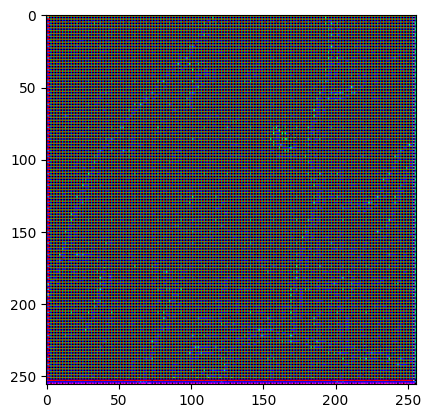

In [35]:
gen_output = generator([inp[tf.newaxis, ...], edg], training=False)
plt.imshow(gen_output[0, ...])

In [36]:
LAMBDA = 100

In [37]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [38]:
def generator_loss(disc_generated_output, gen_output, target):
  # calculates the Binary Crossentropy loss between the discriminator's output and a tensor of ones
  # the generator wants the discriminator's output to be close to 1 (believing the image is real)
  # the loss becomes smaller as the discriminator's output gets closer to 1
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  # encourages the generated image to resemble the target image in terms of pixel values
  # LAMBDA - weight of the MAE compared to the Binary Crossentropy loss
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output)) 

  # combination of 2 losses
  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

In [39]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')
  x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

  x = DownsampleLayer(64, 4, 2, 'same')(x)  # (batch_size, 128, 128, 64)
  x = DownsampleLayer(128, 4, 2, 'same')(x)  # (batch_size, 64, 64, 128)
  x = DownsampleLayer(256, 4, 2, 'same')(x)  # (batch_size, 32, 32, 256)
  x = AttentionLayer(256, x.shape)(x) # (batch_size, 32, 32, 256)
  x = tf.keras.layers.ZeroPadding2D()(x)  # (batch_size, 34, 34, 256)
  x = DownsampleLayer(512, 4, 1, 'valid')(x) # (batch_size, 31, 31, 512)
  x = AttentionLayer(512, x.shape)(x) # (batch_size, 31, 31, 512)
  x = tf.keras.layers.ZeroPadding2D()(x) # (batch_size, 33, 33, 512)
  last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(x)  # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

In [40]:
discriminator = Discriminator()

In [41]:
# tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

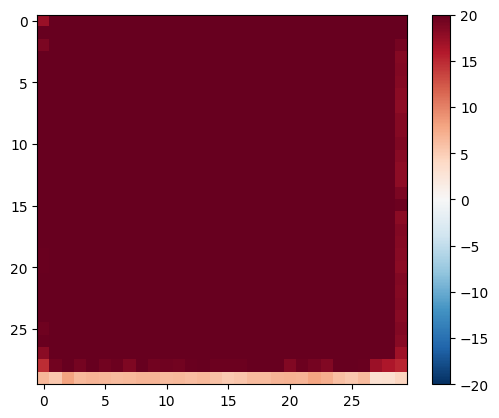

In [42]:
disc_out = discriminator([inp[tf.newaxis, ...], gen_output], training=False)
plt.imshow(disc_out[0, ..., -1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

In [43]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)
  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)
  total_disc_loss = (real_loss + generated_loss) / 2

  return total_disc_loss

In [44]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.75)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.75)

In [45]:
checkpoint_dir = './training_checkpoints_edgeatt'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [46]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))
  display_list = [test_input[0][0], test_input[1], tar[0], prediction[0]]
  title = ['Input Image', 'Input Edges', 'Ground Truth', 'Predicted Image']

  for i in range(4):
    plt.subplot(1, 4, i+1)
    plt.title(title[i])
    if i == 1:
      edges_numpy = display_list[i].numpy()
      plt.imshow(edges_numpy[0, ..., 0], cmap='gray')
      plt.axis('off')
    else:
      plt.imshow(display_list[i] * 0.5 + 0.5)
      plt.axis('off')

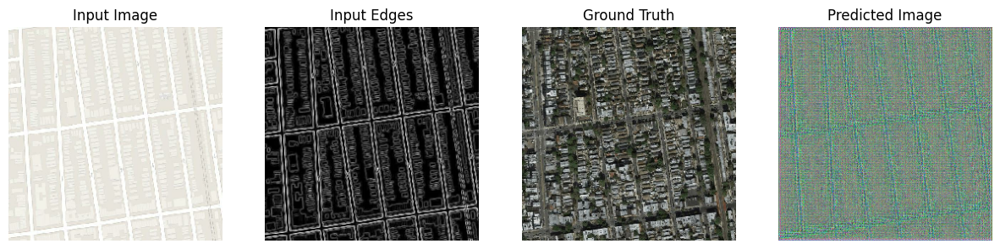

In [47]:
for example_edge, example_input, example_target in test_dataset.take(1):
  generate_images(generator, [example_edge, example_input], example_target)

In [48]:
log_dir="logs/edgeatt"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [49]:
@tf.function
def train_step(input_images, target, step):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_images, training=True)

    disc_real_output = discriminator([input_images[0], target], training=True)
    disc_generated_output = discriminator([input_images[0], gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=step//1000)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=step//1000)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=step//1000)
    tf.summary.scalar('disc_loss', disc_loss, step=step//1000)

In [50]:
def fit(train_ds, test_ds, steps):
  inp, edge, tar = next(iter(test_ds.take(1)))
  start = time.time()

  for step, (input_image, input_edge, target) in train_ds.repeat().take(steps).enumerate():
    if (step) % 1000 == 0:
      display.clear_output(wait=True)
      if step != 0:
        print(f'Time taken for 1000 steps: {time.time()-start:.2f} sec\n')

      start = time.time()

      generate_images(generator, [inp, edge], tar)
      print(f"Step: {step//1000}k")

    train_step([input_image, input_edge], target, step)

    # Training step
    if (step+1) % 10 == 0:
      print('.', end='', flush=True)


    # Save (checkpoint) the model every 5k steps
    if (step + 1) % 5000 == 0:
      checkpoint.save(file_prefix=checkpoint_prefix)

Time taken for 1000 steps: 720.28 sec

Step: 39k
....................................................................................................

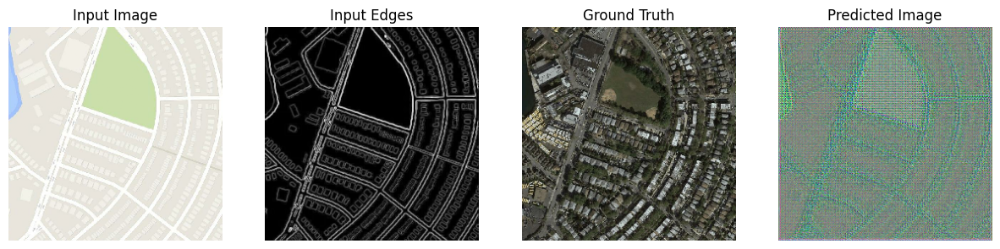

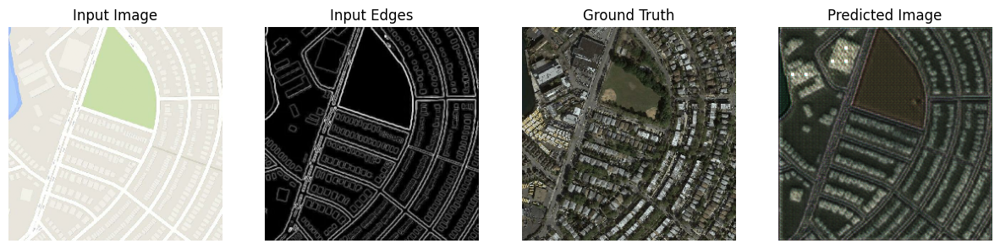

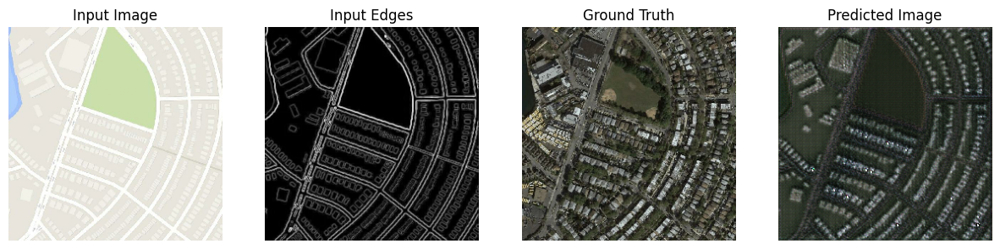

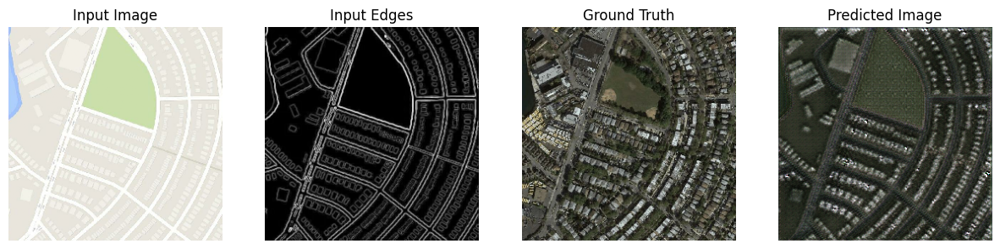

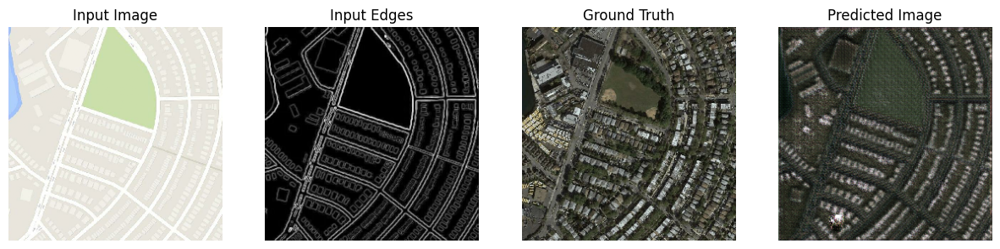

...

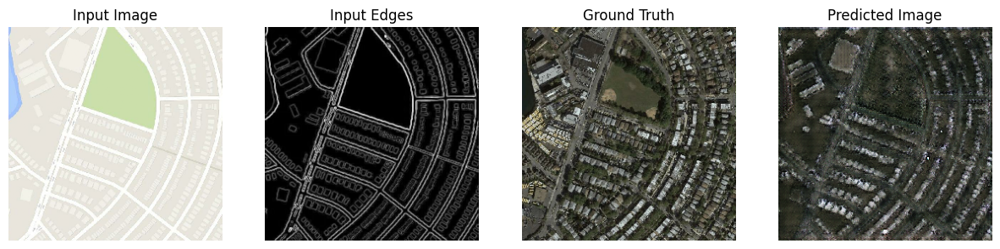

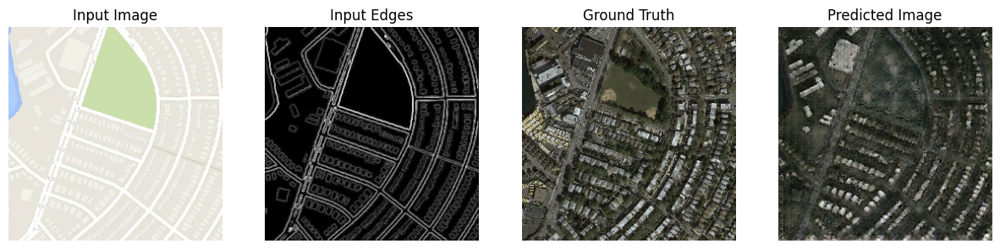

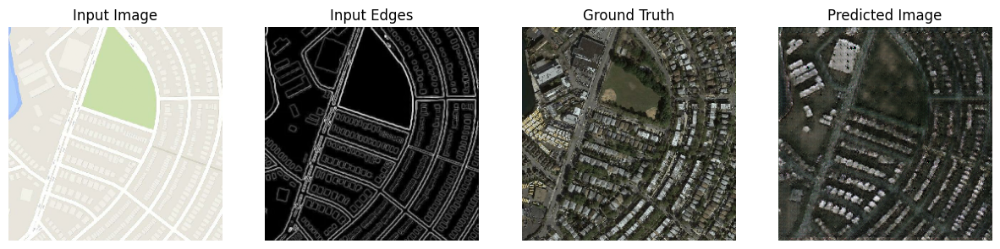

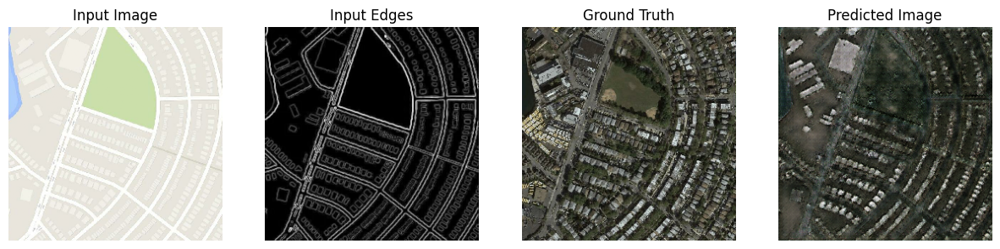

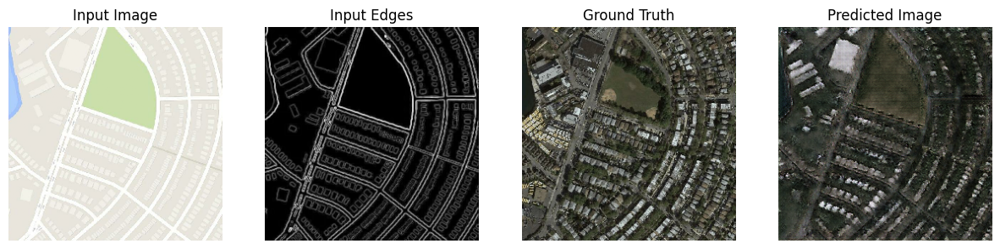

In [51]:
fit(train_dataset, test_dataset, steps=40000)

In [55]:
%load_ext tensorboard
%tensorboard --logdir logs/fit

Reusing TensorBoard on port 6006 (pid 8888), started 2 days, 12:16:33 ago. (Use '!kill 8888' to kill it.)

In [52]:
# Restoring the latest checkpoint in checkpoint_dir
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

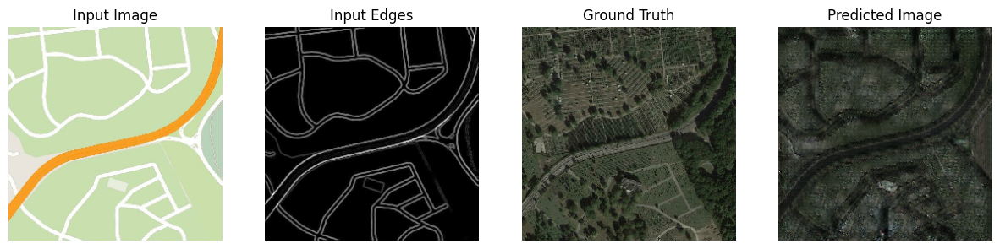

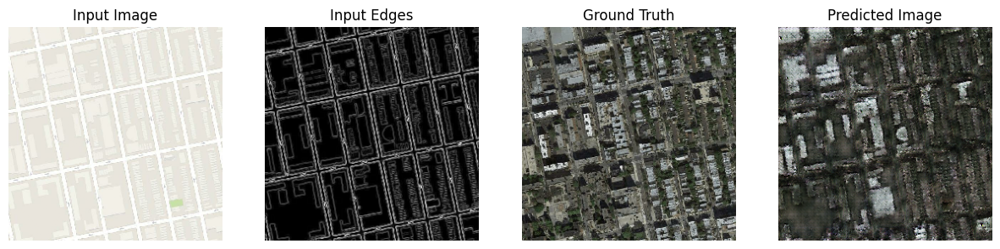

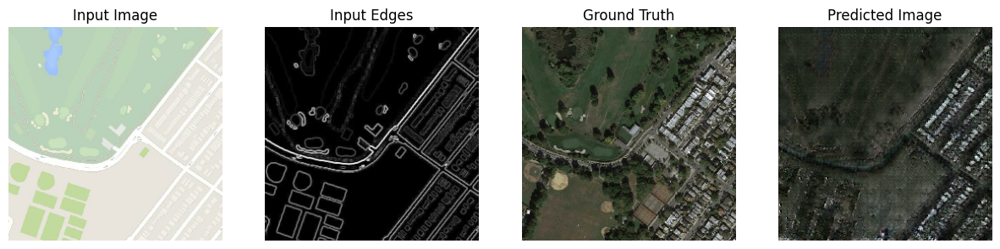

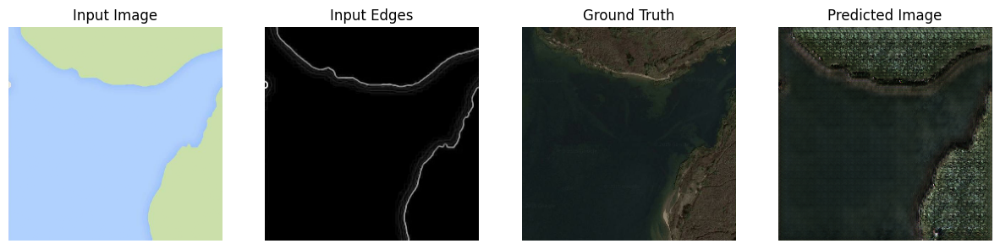

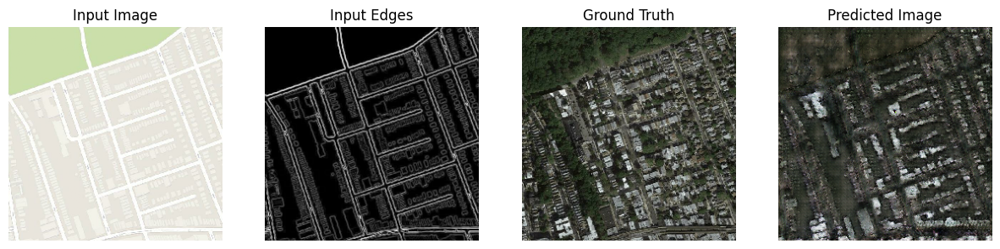

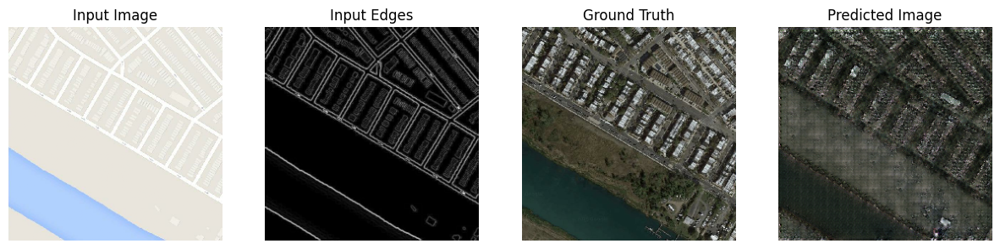

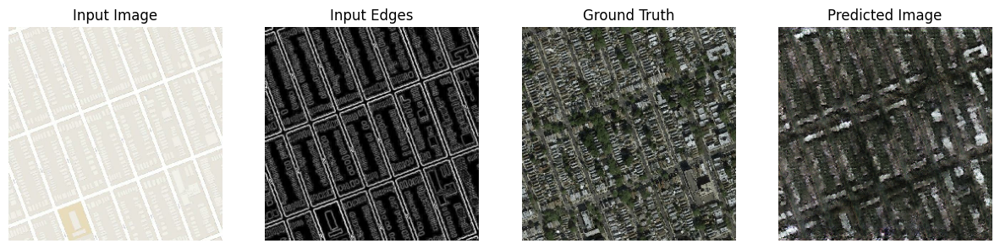

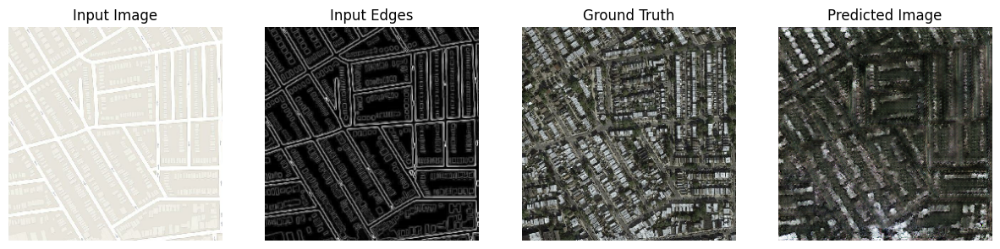

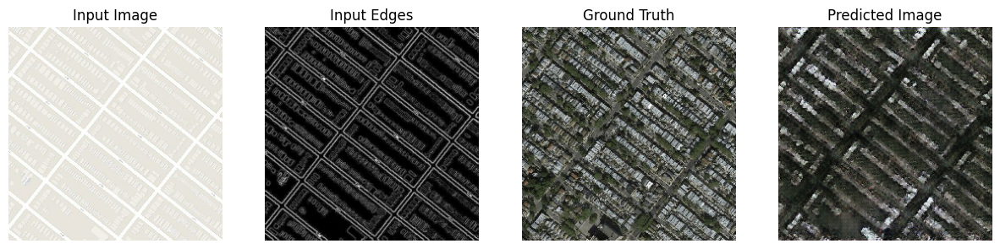

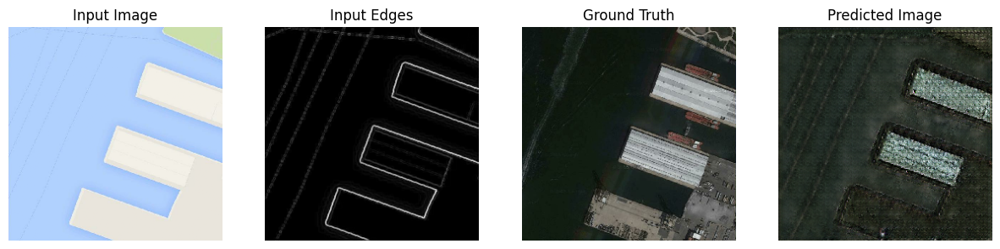

In [54]:
# Run the trained model on a few examples from the test set
for inp, edge, tar in test_dataset.take(10):
  generate_images(generator, [inp,edge], tar)